In [1]:
import pandas as pd
import pathlib
import sys
import numpy as np
from ast import literal_eval
from deepface.commons import distance as dst
from compare_w_reference import compare_w_ref
sys.path.append("../")
from helper.display_cluster import show_cluster, split_ids, locate_and_plot_image, plot_overview_cluster, faceId_to_ogId

# Data loading and preprocessing

## clustering results using facenet and facenet512

In [2]:
base_path = pathlib.Path('/media/bao/t7/la_lib_dataset')
src_folder = base_path / "img"
faces_folder = base_path / "faces"

# results FACENET512 (best f1 score)
res_facenet512 = base_path / "results_dbscan" / "df" / "cluster_Facenet512_DBSCAN_cosine_5_0.24.csv"
df_cluster_512 = pd.read_csv(res_facenet512, usecols={'image', 'cluster_label'})

# results FACENET(128) (best f1 score)
res_facenet128 = base_path / "results_dbscan" / "df" / "cluster_Facenet_DBSCAN_cosine_2_0.22.csv"
df_cluster_128 = pd.read_csv(res_facenet128, usecols={'image', 'cluster_label'})

## load the facenet512 representations for the average embedding

In [3]:
model_name = "Facenet512"
# df = pd.read_csv(df_folder / f"keep_representation_{model_name}.csv", index_col=0, converters={f"{model_name}_representation": literal_eval})
df_representation = pd.read_csv("/media/bao/t7/la_lib_dataset/results_dbscan/df/" + f"keep_representation_{model_name}.csv",usecols={'image', f'{model_name}_representation'}, index_col=0, converters={f"{model_name}_representation": literal_eval}).reset_index()

In [4]:
# merge results on image
df = df_cluster_512.merge(df_cluster_128, on='image', suffixes=('_512', '_128'))

In [5]:
# left join on image only add Facenet512_representation to df
df = df.merge(df_representation[["image", f'{model_name}_representation']], on='image', how='left')

In [6]:
def get_avg_embed(df: pd.DataFrame, model_name:str,  clusterColName: str = "cluster_label") -> pd.DataFrame:
    df_avg_embed = pd.DataFrame(columns=[f"cluster_label", f"avg_{model_name}_representation"])

    # group by cluster_id
    for cluster_id, group in df.groupby(clusterColName):
        # ignore the outliers (-1)
        if cluster_id == -1:
            continue
        
        cluster_name = cluster_id
        
        matrix = np.array(group[f"{model_name}_representation"].tolist())
        avg_embed = np.mean(matrix, axis=0)
        df_avg_embed = pd.concat([df_avg_embed, pd.DataFrame([[avg_embed, cluster_name]], columns=[f"avg_{model_name}_representation", "cluster_label"])], ignore_index=True)
    
    return df_avg_embed

In [7]:
df_avg_embed_512 = get_avg_embed(df, "Facenet512", "cluster_label_512")

In [8]:
# left join on cluster_label only add avg_Facenet512_representation to df
df = df.merge(df_avg_embed_512, left_on="cluster_label_512", right_on="cluster_label", how='left')

In [9]:
def calc_dst_to_mean(row):
    # check if the row is outlier
    if row["cluster_label_512"] == -1:
        return np.NaN
    return dst.findCosineDistance(row["avg_Facenet512_representation"], row["Facenet512_representation"])

df["dst_to_mean"] = df.apply(calc_dst_to_mean, axis=1)

## load the real file name

In [10]:
# dataframe where the original details are stored from the API
df1 = pd.read_csv("/media/bao/t7/la_lib_dataset/df/df1.csv", converters={"metadata": literal_eval})
df2 = pd.read_csv("/media/bao/t7/la_lib_dataset/df/df2.csv", converters={"metadata": literal_eval})
df3 = pd.read_csv("/media/bao/t7/la_lib_dataset/df/df3.csv", converters={"metadata": literal_eval})
df4 = pd.read_csv("/media/bao/t7/la_lib_dataset/df/df4.csv", converters={"metadata": literal_eval})

df_metadata = pd.concat([df1, df2, df3, df4], ignore_index=True)

In [11]:
df_metadata["filename"] = df_metadata["metadata"].apply(lambda x: x.get("filename"))

In [12]:
df["id"] = df["image"].apply(faceId_to_ogId)

In [13]:
# left join on id only add filename to df
df = df.merge(df_metadata[["id", "filename"]], on='id', how='left')

# overview of the clustering 

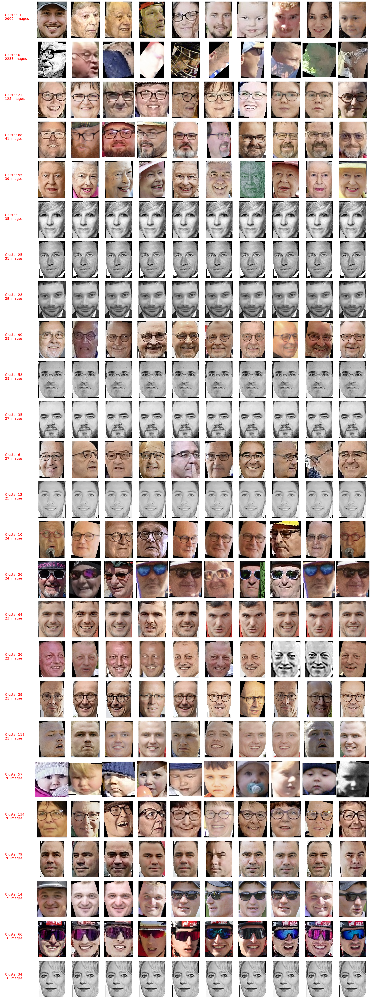

In [14]:
plot_overview_cluster(df, faces_folder, offset=0, nrow=25, ncol=11, clusterColName="cluster_label_512")

# Overview of specific clusters

In [17]:
# create a title column for the plots
df["title"] = df["filename"] + " \n " + df["dst_to_mean"].round(3).astype(str)
# df["title"] = df["dst_to_mean"].round(5).astype(str)

In [15]:
# sort by dst_to_mean
df = df.sort_values(by="dst_to_mean", ascending=True)

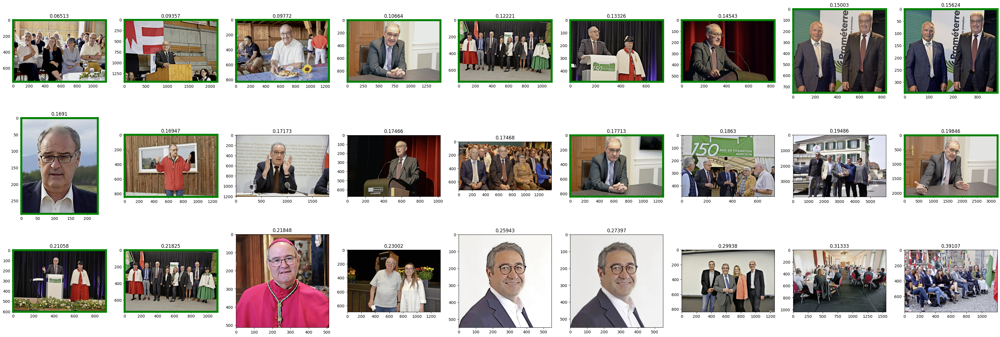

In [31]:
id = "BguHg1iC4mAAd516TgqYm3"
ids_to_highlight, _ = locate_and_plot_image(df=df, image_id=id, faces_folder=faces_folder, originals_folder=src_folder, limit=50, ncol=10, show_original=True, plot=False, save_folder = None, hide_axis=False, title_col = None, marked = [], clusterColName = "cluster_label_128")

ids, _ = locate_and_plot_image(df=df, image_id=id, faces_folder=faces_folder, originals_folder=src_folder, limit=50, ncol=9, show_original=True, plot=True, save_folder = None, hide_axis=False, title_col = "title", marked = ids_to_highlight, clusterColName = "cluster_label_512", marked_color="green")

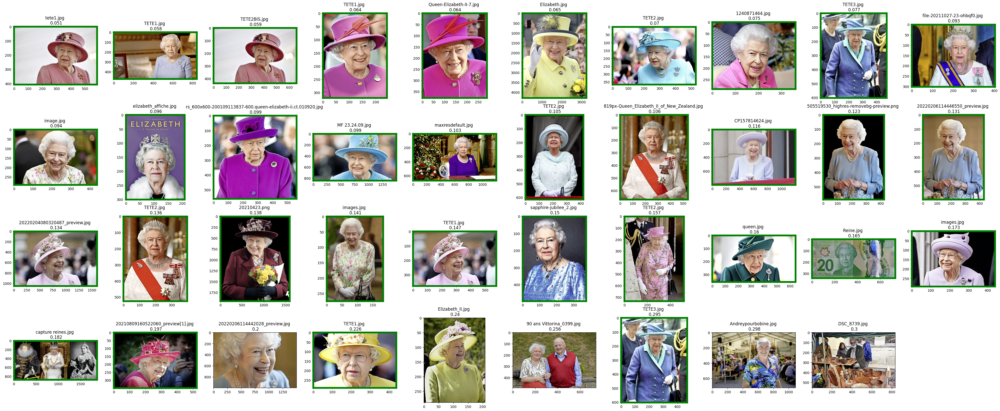

In [21]:
# the queen
id = "8UaM_ACpKHAB03xo4HLtAz"

ids_to_highlight, _ = locate_and_plot_image(df=df, image_id=id, faces_folder=faces_folder, originals_folder=src_folder, limit=50, ncol=10, show_original=True, plot=False, save_folder = None, hide_axis=False, title_col = None, marked = [], clusterColName = "cluster_label_128")

ids, _ = locate_and_plot_image(df=df, image_id=id, faces_folder=faces_folder, originals_folder=src_folder, limit=50, ncol=10, show_original=True, plot=True, save_folder = None, hide_axis=False, title_col = "title", marked = ids_to_highlight, clusterColName = "cluster_label_512", marked_color="green")

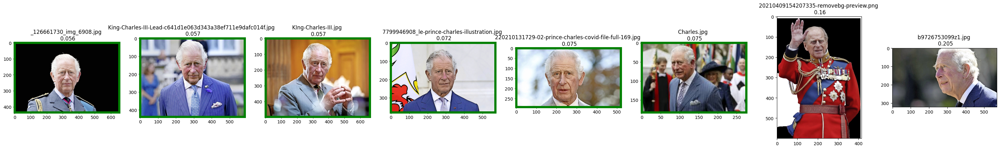

In [19]:
# the king
id = "1Dhs2RWTK5eAjjUBHiw_m9"
ids_to_highlight, _ = locate_and_plot_image(df=df, image_id=id, faces_folder=faces_folder, originals_folder=src_folder, limit=50, ncol=10, show_original=True, plot=False, save_folder = None, hide_axis=False, title_col = None, marked = [], clusterColName = "cluster_label_128")

ids, _ = locate_and_plot_image(df=df, image_id=id, faces_folder=faces_folder, originals_folder=src_folder, limit=50, ncol=8, show_original=True, plot=True, save_folder = None, hide_axis=False, title_col = "title", marked = ids_to_highlight, clusterColName = "cluster_label_512", marked_color="green")

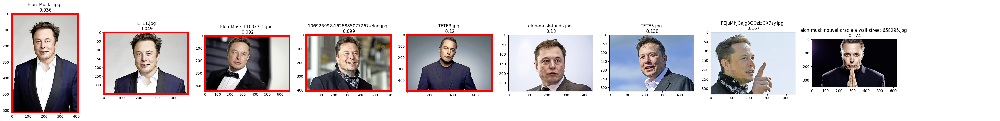

In [18]:
# elon
id = "5Eegciggq6vAXmszqJFueP"
ids_to_highlight, _ = locate_and_plot_image(df=df, image_id=id, faces_folder=faces_folder, originals_folder=src_folder, limit=50, ncol=10, show_original=True, plot=False, save_folder = None, hide_axis=False, title_col = None, marked = [], clusterColName = "cluster_label_128")

ids, _ = locate_and_plot_image(df=df, image_id=id, faces_folder=faces_folder, originals_folder=src_folder, limit=50, ncol=10, show_original=True, plot=True, save_folder = None, hide_axis=False, title_col = "title", marked = ids_to_highlight, clusterColName = "cluster_label_512")

## overview of the biggest clusters

In [15]:
df["cluster_label_512"].value_counts()

-1      29094
 0       2233
 21       125
 88        41
 55        39
        ...  
 174        4
 150        4
 229        4
 252        4
 144        2
Name: cluster_label_512, Length: 277, dtype: int64

In [26]:
start = 3 # 3
end = 10
biggest_clusters = df["cluster_label_512"].value_counts()[start:end].index.to_list()
print(biggest_clusters)

[88, 55, 1, 25, 28, 90, 58]


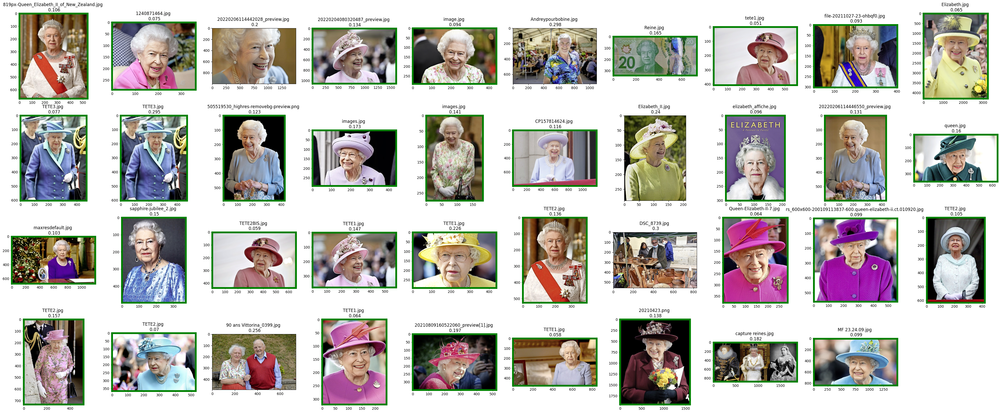

In [18]:
# for id_512 in biggest_clusters:
for id_512 in [55]:

    id_128, _ = df[df["cluster_label_512"] == id_512]["cluster_label_128"].value_counts().reset_index().iloc[0]
    count = df[df["cluster_label_128"] == id_128].shape[0]

    # print(f"cluster_label_512: {id_512} - cluster_label_128: {id_128} - count: {count}")

    if (id_128 != -1) and (count < 100):
        ids_to_highlight, _ = show_cluster(df=df, cluster_id=id_128, faces_folder=faces_folder, originals_folder=src_folder, limit=50, ncol=10, show_original=True, plot=False, save_folder = None, hide_axis=False, title_col = None, marked = [], clusterColName = "cluster_label_128")
    else:
        ids_to_highlight = []

    # ids = show_cluster(df=df, cluster_id=id_512, faces_folder=faces_folder, originals_folder=src_folder, limit=50, ncol=10, show_original=True, plot=True, save_folder = pathlib.Path("../my_cluster/40k-2c"), hide_axis=False, title_col = "title", marked = ids_to_highlight, clusterColName = "cluster_label_512")
    ids = show_cluster(df=df, cluster_id=id_512, faces_folder=faces_folder, originals_folder=src_folder, limit=50, ncol=10, show_original=True, plot=True, save_folder = None, hide_axis=False, title_col = "title", marked = ids_to_highlight, marked_color="green", clusterColName = "cluster_label_512")
    # break

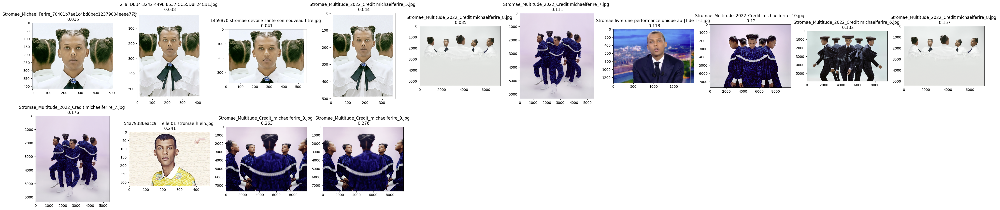

In [31]:
ids = show_cluster(df=df, cluster_id=13, faces_folder=faces_folder, originals_folder=src_folder, limit=50, ncol=10, show_original=True, plot=True, save_folder = None, hide_axis=False, title_col = "title", marked = ids_to_highlight, clusterColName = "cluster_label_512")

# Strategy 1: new clusters are the overlapping clusters

In [10]:
df.head()

,image,cluster_label_512,cluster_label_128,Facenet512_representation,cluster_label,avg_Facenet512_representation,dst_to_mean
0,0-dHzE7f4Yd8PuTtTAKwAN_f0.jpg,0,-1,"[0.03485257551074028, 1.0968769788742065, -0.7...",0,"[0.42531841940447135, -0.25699499533067516, -0...",0.700095
1,0-K-pInL4-eA6-PCzxrUAN_f0.jpg,-1,-1,"[1.491387128829956, 1.6687921285629272, 1.7396...",NaN,NaN,NaN
2,0-kYcIzg4LVBV_f93KfCTh_f0.jpg,-1,-1,"[2.3980321884155273, 0.29073891043663025, 0.42...",NaN,NaN,NaN
3,0-kYcIzg4LVBV_f93KfCTh_f1.jpg,-1,-1,"[3.252713918685913, -0.4528719186782837, 0.687...",NaN,NaN,NaN
4,0-p9MVk7aBr8WBisG6JEe8_f0.jpg,-1,-1,"[0.4406047761440277, 1.5748590230941772, -0.76...",NaN,NaN,NaN


In [11]:
# groupy by cluster_label_512
df_grouped_512 = df.groupby("cluster_label_512")

def get_corresponding_cluster_128(x):
    val_counts = x["cluster_label_128"].value_counts().reset_index()
    # get first value != -1 and count < 100
    for i, row in val_counts.iterrows():
        cluster_id = row["index"] 
        cluster_count = row["cluster_label_128"]
        if (cluster_id != -1) and (cluster_count < 100):
            return cluster_id
    return -1

df_matching_cluster_id = df_grouped_512.apply(lambda x: get_corresponding_cluster_128(x)).reset_index().rename(columns={0: "cluster_label_128"})

In [12]:
# left join df and df_matching_cluster_id
df = df.merge(df_matching_cluster_id, on="cluster_label_512", how="left")

In [13]:
def compute_target_cluster(row):
    cluster_label_128_x = row["cluster_label_128_x"]
    cluster_label_128_y = row["cluster_label_128_y"]
    if cluster_label_128_x == cluster_label_128_y:
        return row["cluster_label_512"]
    else:
        return -1

df["cluster_label"] = df.apply(lambda x: compute_target_cluster(x), axis=1)

In [14]:
df_cluster = df[["image", "cluster_label"]].copy()
df_cluster["face_id"] = df_cluster["image"].apply(pathlib.Path).apply(lambda x: x.stem)

In [15]:
# save df_cluster
df_cluster.to_csv("/media/bao/t7/la_lib_dataset/results_dbscan/dbscanx2/cluster_DBSCANx2_5-2_0.24-0.22.csv", index=False)

In [16]:
df_cluster.head()

,image,cluster_label,face_id
0,0-dHzE7f4Yd8PuTtTAKwAN_f0.jpg,-1,0-dHzE7f4Yd8PuTtTAKwAN_f0
1,0-K-pInL4-eA6-PCzxrUAN_f0.jpg,-1,0-K-pInL4-eA6-PCzxrUAN_f0
2,0-kYcIzg4LVBV_f93KfCTh_f0.jpg,-1,0-kYcIzg4LVBV_f93KfCTh_f0
3,0-kYcIzg4LVBV_f93KfCTh_f1.jpg,-1,0-kYcIzg4LVBV_f93KfCTh_f1
4,0-p9MVk7aBr8WBisG6JEe8_f0.jpg,-1,0-p9MVk7aBr8WBisG6JEe8_f0


In [17]:
reference_clusters_path = pathlib.Path("../reference_clusters")
total_tp, total_fn, total_fp, df_stats = compare_w_ref(reference_clusters_path, df_cluster, faces_folder=faces_folder, src_folder=src_folder)

total_precision = total_tp / (total_tp + total_fp)
total_recall = total_tp / (total_tp + total_fn)
total_f1 = 2 * (total_precision * total_recall) / (total_precision + total_recall)

In [18]:
summary = {
      "model_name": "Facenet512 + Facenet128",
      "clustering_algo": "DBSCANx2",
      "distance_metric": "cosine",
      "min_samples": [5, 2],
      "threshold": [0.24, 0.22],
      "total_tp": total_tp,
      "total_fn": total_fn,
      "total_fp": total_fp,
      "precision": total_precision,
      "recall": total_recall,
      "f1": total_f1
  }

In [19]:
summary

{'model_name': 'Facenet512 + Facenet128',
 'clustering_algo': 'DBSCANx2',
 'distance_metric': 'cosine',
 'min_samples': [5, 2],
 'threshold': [0.24, 0.22],
 'total_tp': 799,
 'total_fn': 237,
 'total_fp': 0,
 'precision': 1.0,
 'recall': 0.7712355212355212,
 'f1': 0.8708446866485012}

In [22]:
df_summary = pd.DataFrame([summary])

In [23]:
df_summary

,model_name,clustering_algo,distance_metric,min_samples,threshold,total_tp,total_fn,total_fp,precision,recall,f1
0,Facenet512 + Facenet128,DBSCANx2,cosine,"[5, 2]","[0.24, 0.22]",799,237,0,1.0,0.771236,0.870845


In [24]:
import os
# save df_summary (append if exists)
save_path = "/media/bao/t7/la_lib_dataset/results_dbscan/dbscanx2/summary_DBSCANx2.csv"
if os.path.exists(save_path):
    df_summary.to_csv(save_path, mode="a", header=False, index=False)
else:
    df_summary.to_csv(save_path, index=False)

# Strategy 2: use the last Facenet128 match to set a threshold

In [10]:
df

,image,cluster_label_512,cluster_label_128,Facenet512_representation,cluster_label,avg_Facenet512_representation,dst_to_mean
0,0-dHzE7f4Yd8PuTtTAKwAN_f0.jpg,0,-1,"[0.03485257551074028, 1.0968769788742065, -0.7...",0,"[0.42531841940447135, -0.25699499533067516, -0...",0.700095
1,0-K-pInL4-eA6-PCzxrUAN_f0.jpg,-1,-1,"[1.491387128829956, 1.6687921285629272, 1.7396...",NaN,NaN,NaN
2,0-kYcIzg4LVBV_f93KfCTh_f0.jpg,-1,-1,"[2.3980321884155273, 0.29073891043663025, 0.42...",NaN,NaN,NaN
3,0-kYcIzg4LVBV_f93KfCTh_f1.jpg,-1,-1,"[3.252713918685913, -0.4528719186782837, 0.687...",NaN,NaN,NaN
4,0-p9MVk7aBr8WBisG6JEe8_f0.jpg,-1,-1,"[0.4406047761440277, 1.5748590230941772, -0.76...",NaN,NaN,NaN
...,...,...,...,...,...,...,...
33742,CcVyLTo9K9VBlkt--EDP97_f2.jpg,-1,-1,"[0.657690167427063, 1.4375221729278564, 1.9792...",NaN,NaN,NaN
33743,CcWCM0zJavo9VOLJsvjeG5_f0.jpg,-1,583,"[0.06719961017370224, 1.0265341997146606, 1.45...",NaN,NaN,NaN
33744,CCyY9IjRKZJ9n3TQCYVI7S_f0.jpg,222,1322,"[-0.7613945007324219, -0.19226108491420746, -1...",222,"[-0.29407340607472826, -0.2278497881655182, -1...",0.151063
33745,CczwTa534Mb8rFFMRiwRCs_f0.jpg,-1,1244,"[0.518186092376709, 2.2859344482421875, 2.1623...",NaN,NaN,NaN


In [11]:
# groupy by cluster_label_512
df_grouped_512 = df.groupby("cluster_label_512")

def get_corresponding_cluster_128(x):
    val_counts = x["cluster_label_128"].value_counts().reset_index()
    # get first value != -1 and count < 100
    for i, row in val_counts.iterrows():
        cluster_id = row["index"] 
        cluster_count = row["cluster_label_128"]
        if (cluster_id != -1) and (cluster_count < 100):
            return cluster_id
    return -1

df_matching_cluster_id = df_grouped_512.apply(lambda x: get_corresponding_cluster_128(x)).reset_index().rename(columns={0: "cluster_label_128"})

# left join df and df_matching_cluster_id
df = df.merge(df_matching_cluster_id, on="cluster_label_512", how="left")

In [12]:
df.head(2)

,image,cluster_label_512,cluster_label_128_x,Facenet512_representation,cluster_label,avg_Facenet512_representation,dst_to_mean,cluster_label_128_y
0,0-dHzE7f4Yd8PuTtTAKwAN_f0.jpg,0,-1,"[0.03485257551074028, 1.0968769788742065, -0.7...",0,"[0.42531841940447135, -0.25699499533067516, -0...",0.700095,366
1,0-K-pInL4-eA6-PCzxrUAN_f0.jpg,-1,-1,"[1.491387128829956, 1.6687921285629272, 1.7396...",NaN,NaN,NaN,1011


In [186]:
low_th = 0.10

In [187]:
df_grouped_512 = df.groupby("cluster_label_512")

def get_max_th(x):
    max_th = x[x["cluster_label_128_x"] == x["cluster_label_128_y"]]["dst_to_mean"].max()
    if np.isnan(max_th):
        return low_th # default value
    if max_th < low_th:
        return low_th
    return max_th

df_max_ths = df_grouped_512.apply(lambda x: get_max_th(x)).reset_index().rename(columns={0: "max_th"})

In [188]:
df_res = df.merge(df_max_ths, on="cluster_label_512", how="left")

In [189]:
def compute_target_cluster(row):
    dst_to_mean = row["dst_to_mean"]
    max_th = row["max_th"]
    if dst_to_mean <= max_th:
        return row["cluster_label_512"]
    return -1

df_res["cluster_label"] = df_res.apply(lambda x: compute_target_cluster(x), axis=1)

In [190]:
df_cluster = df_res[["image", "cluster_label"]].copy()
df_cluster["face_id"] = df_cluster["image"].apply(pathlib.Path).apply(lambda x: x.stem)

In [191]:
# save df_cluster
df_cluster.to_csv(f"/media/bao/t7/la_lib_dataset/results_dbscan/dbscanx2/cluster_DBSCANx2_threshold_{low_th}.csv", index=False)

In [192]:
reference_clusters_path = pathlib.Path("../reference_clusters")
total_tp, total_fn, total_fp, df_stats = compare_w_ref(reference_clusters_path, df_cluster, faces_folder=faces_folder, src_folder=src_folder)

total_precision = total_tp / (total_tp + total_fp)
total_recall = total_tp / (total_tp + total_fn)
total_f1 = 2 * (total_precision * total_recall) / (total_precision + total_recall)

In [193]:
summary = {
      "model_name": "Facenet512 + Facenet128",
      "clustering_algo": f"DBSCAN + l_th {low_th}",
      "distance_metric": "cosine",
      "min_samples": [5, 2],
      "threshold": [0.24, 0.22],
      "total_tp": total_tp,
      "total_fn": total_fn,
      "total_fp": total_fp,
      "precision": total_precision,
      "recall": total_recall,
      "f1": total_f1
  }

In [194]:
summary

{'model_name': 'Facenet512 + Facenet128',
 'clustering_algo': 'DBSCAN + l_th 0.1',
 'distance_metric': 'cosine',
 'min_samples': [5, 2],
 'threshold': [0.24, 0.22],
 'total_tp': 889,
 'total_fn': 147,
 'total_fp': 5,
 'precision': 0.9944071588366891,
 'recall': 0.8581081081081081,
 'f1': 0.9212435233160621}

In [195]:
df_summary = pd.DataFrame([summary])

In [196]:
import os
# save df_summary (append if exists)
my_path = "/media/bao/t7/la_lib_dataset/results_dbscan/dbscanx2/summary_DBSCANx2_lthreshold.csv"
if os.path.exists(my_path):
    df_summary.to_csv(my_path, mode="a", header=False, index=False)
else:
    df_summary.to_csv(my_path, index=False)